In [27]:
from pathlib import Path
from json import  loads
import numpy as np
from skimage.draw import polygon
from PIL import Image, ImageOps
import cv2
import matplotlib.pyplot as plt

In [ ]:
path = './data_original_size/'
file = '19_00137.jpg'

original_image = Image.open(path+file).convert("RGB")
file_name = file.split('.')[0]
mask_data = loads(open(path + file_name + '.json').read())

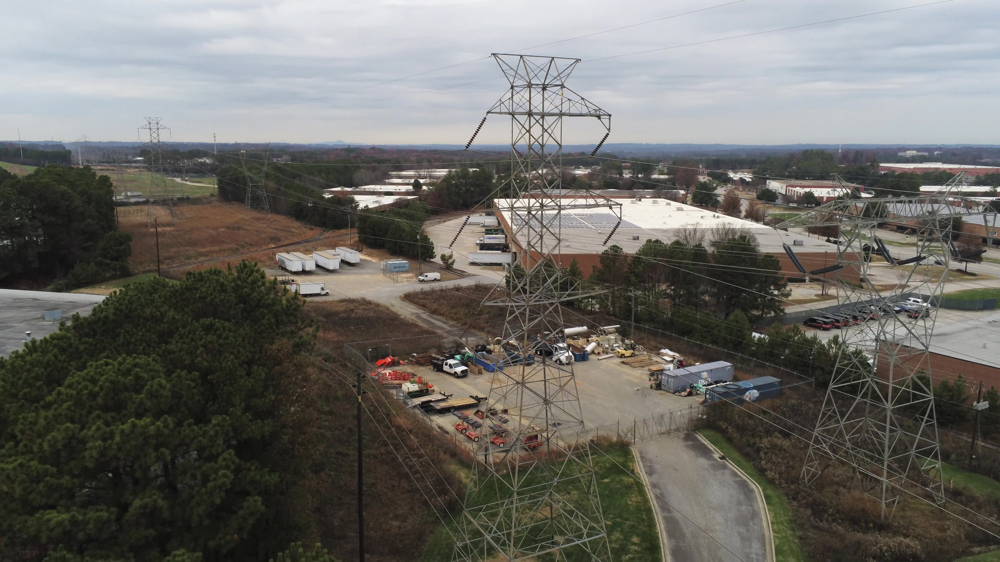

In [4]:
original_image

In [5]:
original_image.size

(3840, 2160)

In [13]:
cables = [data for data in mask_data['shapes'] if data["label"] == 'cable']
x_max = 0
y_max = 0
for cable in cables:
    for point in cable['points']:
        x, y = point[0], point[1]
        x_max, y_max = max(x, x_max), max(y, y_max)
        
print(f'x_max = {x_max}, y_max = {y_max}')

x_max = 3842.390070921986, y_max = 2158.8652482269504


In [19]:
def get_pixels(file_name):
    path = './data_original_size/'
    file = f'{file_name}.jpg'

    original_image = Image.open(path+file).convert("RGB")
    file_name = file.split('.')[0]
    mask_data = loads(open(path + file_name + '.json').read())

    print(f'image size: {original_image.size}')

    cables = [data for data in mask_data['shapes'] if data["label"] == 'cable']
    x_max = 0
    y_max = 0
    for cable in cables:
        for point in cable['points']:
            x, y = point[0], point[1]
            x_max, y_max = max(x, x_max), max(y, y_max)
            
    print(f'x_max = {x_max}, y_max = {y_max}')
    
    
with open('not_found_mask.txt', 'r') as f:
    img_list = [line.replace('\n','') for line in f.readlines()]

for n in img_list:
    get_pixels(n)
    print()

image size: (3840, 2160)
x_max = 3841.1111111111113, y_max = 2159.0

image size: (3840, 2160)
x_max = 3842.087719298245, y_max = 2159.0

image size: (3840, 2160)
x_max = 3841.6939890710382, y_max = 2159.0

image size: (3840, 2160)
x_max = 3842.390070921986, y_max = 2158.8652482269504

image size: (3840, 2160)
x_max = 3846.666666666667, y_max = 2157.890625

image size: (3840, 2160)
x_max = 3836.25, y_max = 2162.463768115942

image size: (3840, 2160)
x_max = 3846.931818181824, y_max = 1879.453125

image size: (3840, 2160)
x_max = 3840.51497005988, y_max = 2158.490566037736

image size: (3840, 2160)
x_max = 3841.9894366197195, y_max = 1069.3069306930693

image size: (3840, 2160)
x_max = 3836.25, y_max = 2160.6040933098593

image size: (3840, 2160)
x_max = 3838.181818181818, y_max = 2162.5

image size: (3840, 2160)
x_max = 3165.0, y_max = 2163.6442120622555

image size: (3840, 2160)
x_max = 3847.6271186440795, y_max = 2157.890625

image size: (3840, 2160)
x_max = 3191.140776699029, y_max =

In [23]:
x_max, y_max

(3840, 2160)

In [61]:
path = './data_original_size/'
file = '32_00561'

img_path = f'{path}{file}.jpg'
mask_path = f'{path}{file}_mask.jpg'

original_image = Image.open(img_path).convert("RGBA")

mask_image = Image.open(mask_path).convert("L")

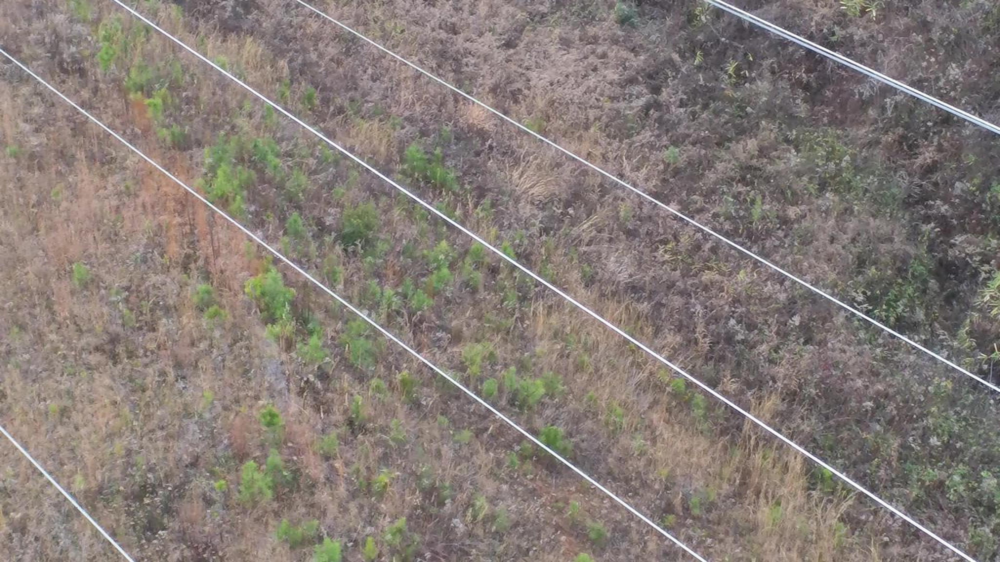

In [62]:
original_image

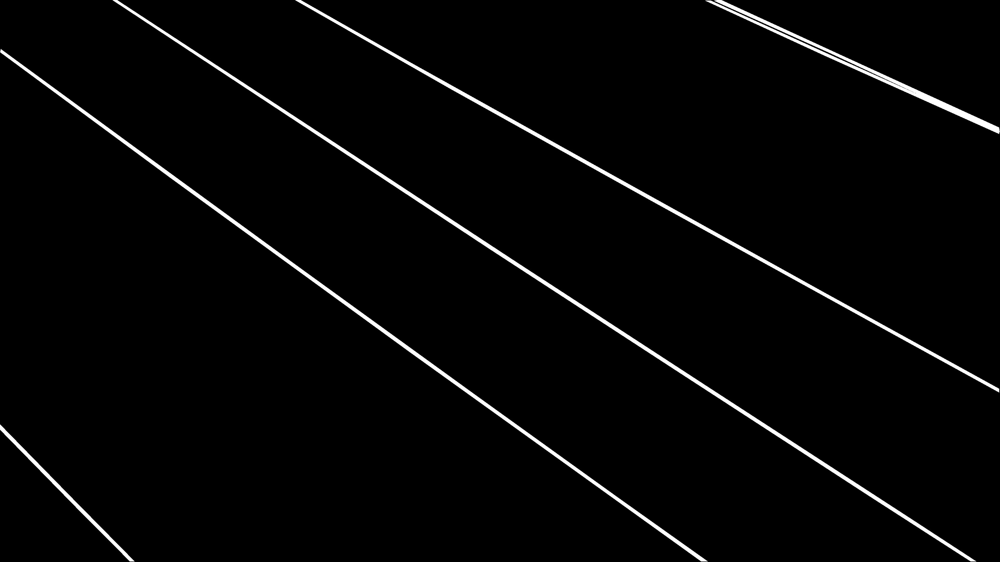

In [63]:
mask_image

In [64]:
print(mask_image.size)
print(original_image.size)

(3840, 2160)
(3840, 2160)


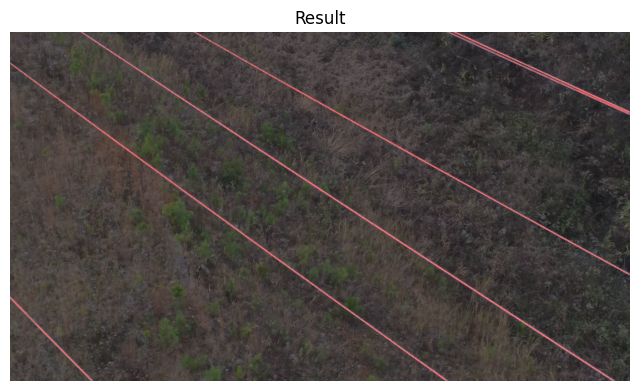

In [65]:
import cv2
import numpy as np

# Carregue a imagem de entrada
image = cv2.imread(img_path)

# Carregue a máscara binária
# Certifique-se de que a máscara está em escala de cinza (0 e 255)
mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)  # Altere 'mask.png' para o caminho do seu arquivo de máscara

# Verifique se a máscara tem o mesmo tamanho que a imagem
if mask.shape != image.shape[:2]:
    mask = cv2.resize(mask, (image.shape[1], image.shape[0]))  # Redimensione se necessário

# Crie uma imagem colorida para a máscara
colored_mask = np.zeros_like(image)  # Crie uma imagem vazia do mesmo tamanho que a imagem original
colored_mask[mask == 255] = [0, 0, 255]  # Preencha a área da máscara com vermelho (BGR)

# Aplique transparência
alpha = 0.5  # Nível de transparência da máscara
result = cv2.addWeighted(image, 1 - alpha, colored_mask, alpha, 0)


# Converta a imagem de BGR para RGB
result = cv2.cvtColor(result, cv2.COLOR_BGR2RGB)

# Plote apenas o resultado
plt.figure(figsize=(8, 6))
plt.imshow(result)
plt.title('Result')
plt.axis('off')  # Remove os eixos
plt.show()

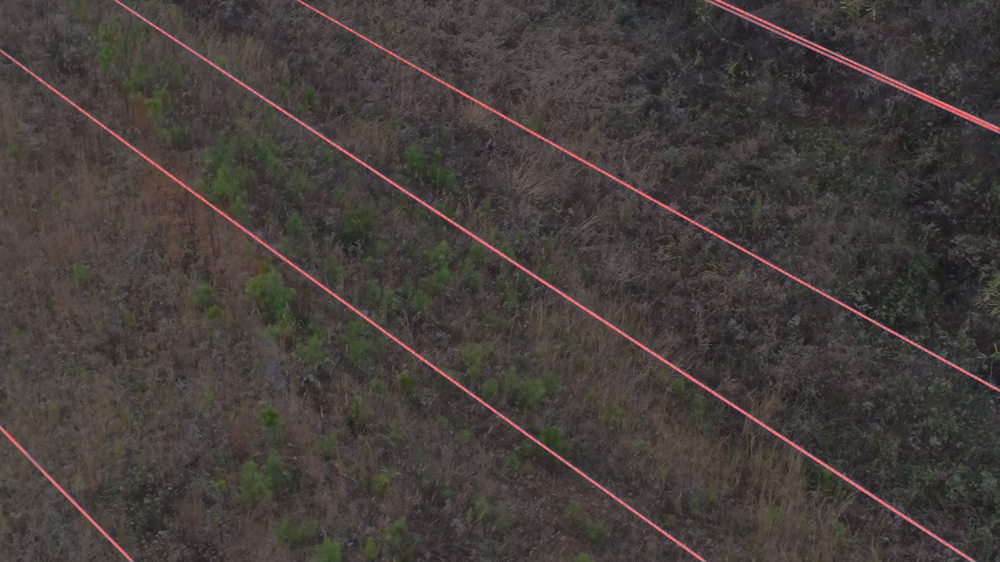

In [66]:
result_pil = Image.fromarray(result)
result_pil